# Problem Statement


**Business Problem Overview:**

In the fiercely competitive telecom industry, where customers can easily switch between service providers, a significant challenge is the annual churn rate ranging from 15-25%. Given the substantial cost of acquiring new customers, the focus on customer retention has become paramount. Retaining high-profit customers is a top priority for incumbent operators. Predicting which customers are at high risk of churn is crucial to minimize revenue leakage. This project aims to analyze customer-level data for a leading telecom firm, develop predictive models to identify high-value customers prone to churn, and pinpoint key indicators of churn.

**Defining Churn:**

Churn is defined in a usage-based manner, focusing on customers who have not engaged in any activity, either incoming or outgoing, such as calls or internet usage, over a specified period. The project particularly emphasizes churn prediction for high-value customers, constituting the top 20% contributing approximately 80% of revenue.

**Understanding Customer Behavior During Churn:**

Customer churn typically evolves over three phases: the 'good' phase, where customers are content; the 'action' phase, marked by declining satisfaction and potential high-churn risk; and the 'churn' phase, indicating the actual departure. Predicting churn during the 'action' phase is crucial for timely corrective actions.

**Data Preparation:**

Derive new features based on business understanding.
Filter high-value customers, defined as those recharging above the 70th percentile of average recharge amount in the 'good' phase.
Tag churners based on zero activity in calls and mobile internet during the 'churn' phase.
Remove attributes corresponding to the 'churn' phase.

**Modeling Approach:**

Preprocess data, handle missing values, and explore insights.

Derive new features and reduce dimensionality using PCA.

Train various models, addressing class imbalance, and evaluate using appropriate metrics.

Choose a model for predicting churn.

Build a second model, such as logistic regression or a tree-based model, to identify important predictor attributes.

**Recommendations:**

Propose strategies for customer retention based on identified indicators of churn.

Utilize insights to offer special plans or discounts to at-risk high-value customers during the 'action' phase.

Employ visualizations to effectively convey the importance of features and aid in decision-making.




### Importing Libraries

In [161]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
# %matplotlib inline

# Supressing the warnings generated
import warnings
warnings.filterwarnings('ignore')



### Data Understanding

In [162]:
telecom_data = pd.read_csv("telecom_churn_data.csv")
telecom_data.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,...,0,1.0,1.0,1.0,NaN,968,30.4,0.0,101.20,3.58
1,7001865778,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,34.047,...,0,NaN,1.0,1.0,NaN,1006,0.0,0.0,0.00,0.00
2,7001625959,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,167.690,...,0,NaN,NaN,NaN,1.0,1103,0.0,0.0,4.17,0.00
3,7001204172,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,221.338,...,0,NaN,NaN,NaN,NaN,2491,0.0,0.0,0.00,0.00
4,7000142493,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,261.636,...,0,0.0,NaN,NaN,NaN,1526,0.0,0.0,0.00,0.00


In [163]:
telecom_data.shape

(99999, 226)

 **This telecom dataset has 99999 rows and 226 columns**

In [164]:
telecom_data.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Data columns (total 226 columns):
 #    Column                    Dtype  
---   ------                    -----  
 0    mobile_number             int64  
 1    circle_id                 int64  
 2    loc_og_t2o_mou            float64
 3    std_og_t2o_mou            float64
 4    loc_ic_t2o_mou            float64
 5    last_date_of_month_6      object 
 6    last_date_of_month_7      object 
 7    last_date_of_month_8      object 
 8    last_date_of_month_9      object 
 9    arpu_6                    float64
 10   arpu_7                    float64
 11   arpu_8                    float64
 12   arpu_9                    float64
 13   onnet_mou_6               float64
 14   onnet_mou_7               float64
 15   onnet_mou_8               float64
 16   onnet_mou_9               float64
 17   offnet_mou_6              float64
 18   offnet_mou_7              float64
 19   offnet_mou_8              float64
 20   offn

In [165]:
telecom_data.columns

Index(['mobile_number', 'circle_id', 'loc_og_t2o_mou', 'std_og_t2o_mou',
       'loc_ic_t2o_mou', 'last_date_of_month_6', 'last_date_of_month_7',
       'last_date_of_month_8', 'last_date_of_month_9', 'arpu_6',
       ...
       'sachet_3g_9', 'fb_user_6', 'fb_user_7', 'fb_user_8', 'fb_user_9',
       'aon', 'aug_vbc_3g', 'jul_vbc_3g', 'jun_vbc_3g', 'sep_vbc_3g'],
      dtype='object', length=226)

In [166]:
# Statistical analysis of the numercial features
telecom_data.describe().T


,count,mean,std,min,25%,50%,75%,max
mobile_number,99999.0,7.001207e+09,695669.386290,7.000000e+09,7.000606e+09,7.001205e+09,7.001812e+09,7.002411e+09
circle_id,99999.0,1.090000e+02,0.000000,1.090000e+02,1.090000e+02,1.090000e+02,1.090000e+02,1.090000e+02
loc_og_t2o_mou,98981.0,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
std_og_t2o_mou,98981.0,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
loc_ic_t2o_mou,98981.0,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...
aon,99999.0,1.219855e+03,954.733842,1.800000e+02,4.670000e+02,8.630000e+02,1.807500e+03,4.337000e+03
aug_vbc_3g,99999.0,6.817025e+01,267.580450,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.291622e+04
jul_vbc_3g,99999.0,6.683906e+01,271.201856,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,9.165600e+03
jun_vbc_3g,99999.0,6.002120e+01,253.938223,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.116621e+04


In [167]:
telecom_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 226 entries, mobile_number to sep_vbc_3g
dtypes: float64(179), int64(35), object(12)
memory usage: 172.4+ MB


### **Data Cleaning and Preparation**



In [168]:
# rename the columns
telecom_data.rename(columns = {'aug_vbc_3g':'vbc_3g_8','sep_vbc_3g':'vbc_3g_9','jun_vbc_3g':'vbc_3g_6','jul_vbc_3g':'vbc_3g_7'}, inplace = True)

In [169]:
# some recharge columns have minimum value of 1 while some don't
recharge_cols = ['total_rech_data_6', 'total_rech_data_7', 'total_rech_data_8', 'total_rech_data_9',
                 'count_rech_2g_6', 'count_rech_2g_7', 'count_rech_2g_8', 'count_rech_2g_9',
                 'count_rech_3g_6', 'count_rech_3g_7', 'count_rech_3g_8', 'count_rech_3g_9',
                 'max_rech_data_6', 'max_rech_data_7', 'max_rech_data_8', 'max_rech_data_9',
                 'av_rech_amt_data_6', 'av_rech_amt_data_7', 'av_rech_amt_data_8', 'av_rech_amt_data_9',
                 ]

telecom_data[recharge_cols].describe(include='all')

,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9
count,25153.000000,25571.000000,26339.000000,25922.000000,25153.000000,25571.000000,26339.000000,25922.000000,25153.000000,25571.000000,26339.000000,25922.000000,25153.000000,25571.000000,26339.000000,25922.00000,25153.000000,25571.000000,26339.000000,25922.000000
mean,2.463802,2.666419,2.651999,2.441170,1.864668,2.044699,2.016288,1.781807,0.599133,0.621720,0.635711,0.659363,126.393392,126.729459,125.717301,124.94144,192.600982,200.981292,197.526489,192.734315
std,2.789128,3.031593,3.074987,2.516339,2.570254,2.768332,2.720132,2.214701,1.274428,1.394524,1.422827,1.411513,108.477235,109.765267,109.437851,111.36376,192.646318,196.791224,191.301305,188.400286
min,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.00000,1.000000,0.500000,0.500000,1.000000
25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,25.000000,25.000000,25.000000,25.00000,82.000000,92.000000,87.000000,69.000000
50%,1.000000,1.000000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,145.000000,145.000000,145.000000,145.00000,154.000000,154.000000,154.000000,164.000000
75%,3.000000,3.000000,3.000000,3.000000,2.000000,2.000000,2.000000,2.000000,1.000000,1.000000,1.000000,1.000000,177.000000,177.000000,179.000000,179.00000,252.000000,252.000000,252.000000,252.000000
max,61.000000,54.000000,60.000000,84.000000,42.000000,48.000000,44.000000,40.000000,29.000000,35.000000,45.000000,49.000000,1555.000000,1555.000000,1555.000000,1555.00000,7546.000000,4365.000000,4076.000000,4061.000000


In [170]:
# It is also observed that the recharge date and the recharge value are missing together which means the customer didn't recharge
telecom_data.loc[telecom_data.total_rech_data_6.isnull() & telecom_data.date_of_last_rech_data_6.isnull(), ["total_rech_data_6", "date_of_last_rech_data_6"]].head(20)

,total_rech_data_6,date_of_last_rech_data_6
1,NaN,NaN
2,NaN,NaN
3,NaN,NaN
5,NaN,NaN
6,NaN,NaN
7,NaN,NaN
8,NaN,NaN
9,NaN,NaN
10,NaN,NaN
11,NaN,NaN


In the recharge variables where minumum value is 1, we can impute missing values with zeroes since it means customer didn't recharge their numbere that month.

In [171]:
# create a list of recharge columns where we will impute missing values with zeroes
zero_impute = ['total_rech_data_6', 'total_rech_data_7', 'total_rech_data_8', 'total_rech_data_9',
        'av_rech_amt_data_6', 'av_rech_amt_data_7', 'av_rech_amt_data_8', 'av_rech_amt_data_9',
        'max_rech_data_6', 'max_rech_data_7', 'max_rech_data_8', 'max_rech_data_9'
       ]

In [172]:
# impute missing values with 0
telecom_data[zero_impute] = telecom_data[zero_impute].apply(lambda x: x.fillna(0))

In [173]:
# now, let's make sure values are imputed correctly
print("Missing value ratio:\n")
print(telecom_data[zero_impute].isnull().sum()*100/telecom_data.shape[1])

# summary
print("\n\nSummary statistics\n")
print(telecom_data[zero_impute].describe(include='all'))

Missing value ratio:

total_rech_data_6     0.0
total_rech_data_7     0.0
total_rech_data_8     0.0
total_rech_data_9     0.0
av_rech_amt_data_6    0.0
av_rech_amt_data_7    0.0
av_rech_amt_data_8    0.0
av_rech_amt_data_9    0.0
max_rech_data_6       0.0
max_rech_data_7       0.0
max_rech_data_8       0.0
max_rech_data_9       0.0
dtype: float64


Summary statistics

       total_rech_data_6  total_rech_data_7  total_rech_data_8  \
count       99999.000000       99999.000000       99999.000000   
mean            0.619726           0.681837           0.698517   
std             1.760541           1.924382           1.963417   
min             0.000000           0.000000           0.000000   
25%             0.000000           0.000000           0.000000   
50%             0.000000           0.000000           0.000000   
75%             1.000000           1.000000           1.000000   
max            61.000000          54.000000          60.000000   

       total_rech_data_9  av_rech_

In [174]:
# Selecting only columns which Object Datatype
obj_col=telecom_data.select_dtypes(['object']).columns.tolist()
telecom_data[obj_col]

,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9
0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/21/2014,7/16/2014,8/8/2014,9/28/2014,6/21/2014,7/16/2014,8/8/2014,NaN
1,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/29/2014,7/31/2014,8/28/2014,9/30/2014,NaN,7/25/2014,8/10/2014,NaN
2,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/17/2014,7/24/2014,8/14/2014,9/29/2014,NaN,NaN,NaN,9/17/2014
3,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/28/2014,7/31/2014,8/31/2014,9/30/2014,NaN,NaN,NaN,NaN
4,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/26/2014,7/28/2014,8/9/2014,9/28/2014,6/4/2014,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
99994,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/3/2014,7/20/2014,8/26/2014,9/25/2014,NaN,NaN,NaN,NaN
99995,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/17/2014,7/17/2014,8/24/2014,9/26/2014,NaN,NaN,NaN,NaN
99996,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/13/2014,7/26/2014,NaN,9/2/2014,6/13/2014,NaN,NaN,NaN
99997,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/17/2014,7/19/2014,8/20/2014,9/17/2014,6/17/2014,7/19/2014,8/20/2014,9/17/2014


The date columns don't add any value excpet for marking the last day of the period so we will drop them.

In [175]:
# Let us drop the date columns as they do not infer anything
telecom_data.drop(obj_col,axis=1,inplace=True)
telecom_data.shape

(99999, 214)

In [176]:
telecom_data.select_dtypes(['object']).columns.tolist()

[]

There is zero object type of columns in the dataset

In [177]:
((telecom_data.isnull().sum()/telecom_data.shape[0])*100).round(2).sort_values(ascending=False)


arpu_3g_6             74.85
count_rech_2g_6       74.85
arpu_2g_6             74.85
night_pck_user_6      74.85
count_rech_3g_6       74.85
                      ...  
last_day_rch_amt_6     0.00
max_rech_amt_9         0.00
max_rech_amt_8         0.00
max_rech_amt_7         0.00
vbc_3g_9               0.00
Length: 214, dtype: float64

In [178]:
# Let's now check the percentage of missing values in each column

missing_percentage = round(100*(telecom_data.isnull().sum()/len(telecom_data.index)), 2)
missing_percentage

mobile_number     0.00
circle_id         0.00
loc_og_t2o_mou    1.02
std_og_t2o_mou    1.02
loc_ic_t2o_mou    1.02
                  ... 
aon               0.00
vbc_3g_8          0.00
vbc_3g_7          0.00
vbc_3g_6          0.00
vbc_3g_9          0.00
Length: 214, dtype: float64

In [179]:
missing_percentage[missing_percentage > 40]

count_rech_2g_6     74.85
count_rech_2g_7     74.43
count_rech_2g_8     73.66
count_rech_2g_9     74.08
count_rech_3g_6     74.85
count_rech_3g_7     74.43
count_rech_3g_8     73.66
count_rech_3g_9     74.08
arpu_3g_6           74.85
arpu_3g_7           74.43
arpu_3g_8           73.66
arpu_3g_9           74.08
arpu_2g_6           74.85
arpu_2g_7           74.43
arpu_2g_8           73.66
arpu_2g_9           74.08
night_pck_user_6    74.85
night_pck_user_7    74.43
night_pck_user_8    73.66
night_pck_user_9    74.08
fb_user_6           74.85
fb_user_7           74.43
fb_user_8           73.66
fb_user_9           74.08
dtype: float64

In [180]:
#Droping Columns
telecom_data.drop(columns = missing_percentage[missing_percentage > 40].index, axis=1,inplace=True)
telecom_data.shape

(99999, 190)

In [181]:
telecom_data.head(15)

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,...,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,vbc_3g_9
0,7000842753,109,0.0,0.0,0.0,197.385,214.816,213.803,21.100,NaN,...,0,0,0,0,0,968,30.40,0.00,101.20,3.58
1,7001865778,109,0.0,0.0,0.0,34.047,355.074,268.321,86.285,24.11,...,0,0,0,0,0,1006,0.00,0.00,0.00,0.00
2,7001625959,109,0.0,0.0,0.0,167.690,189.058,210.226,290.714,11.54,...,0,0,0,0,0,1103,0.00,0.00,4.17,0.00
3,7001204172,109,0.0,0.0,0.0,221.338,251.102,508.054,389.500,99.91,...,0,0,0,0,0,2491,0.00,0.00,0.00,0.00
4,7000142493,109,0.0,0.0,0.0,261.636,309.876,238.174,163.426,50.31,...,0,0,0,0,0,1526,0.00,0.00,0.00,0.00
5,7000286308,109,0.0,0.0,0.0,50.258,58.810,83.386,170.826,50.16,...,0,0,0,0,0,1471,0.00,0.00,0.00,0.00
6,7001051193,109,0.0,0.0,0.0,429.023,190.704,255.114,114.751,71.03,...,0,0,0,0,0,1673,0.00,0.00,0.00,0.00
7,7000701601,109,0.0,0.0,0.0,1069.180,1349.850,3171.480,500.000,57.84,...,0,0,0,0,0,802,57.74,19.38,18.74,0.00
8,7001524846,109,0.0,0.0,0.0,378.721,492.223,137.362,166.787,413.69,...,0,0,0,0,0,315,21.03,910.65,122.16,0.00
9,7001864400,109,0.0,0.0,0.0,119.518,247.435,170.231,160.042,33.89,...,0,0,0,0,0,902,0.00,0.00,0.00,0.00


In [182]:
round(100*(telecom_data.isnull().sum()/len(telecom_data.index)), 2)

mobile_number     0.00
circle_id         0.00
loc_og_t2o_mou    1.02
std_og_t2o_mou    1.02
loc_ic_t2o_mou    1.02
                  ... 
aon               0.00
vbc_3g_8          0.00
vbc_3g_7          0.00
vbc_3g_6          0.00
vbc_3g_9          0.00
Length: 190, dtype: float64

In [183]:
# Finding columns that have a single value
uniq_col= telecom_data.columns[telecom_data.nunique()==1]
uniq_col

Index(['circle_id', 'loc_og_t2o_mou', 'std_og_t2o_mou', 'loc_ic_t2o_mou',
       'std_og_t2c_mou_6', 'std_og_t2c_mou_7', 'std_og_t2c_mou_8',
       'std_og_t2c_mou_9', 'std_ic_t2o_mou_6', 'std_ic_t2o_mou_7',
       'std_ic_t2o_mou_8', 'std_ic_t2o_mou_9'],
      dtype='object')

In [184]:
telecom_data[uniq_col].head(10)

,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9
0,109,0.0,0.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN
1,109,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,109,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,109,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,109,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,109,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,109,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,109,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,NaN
8,109,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,109,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [185]:
telecom_data.drop(uniq_col,axis=1,inplace=True)
telecom_data.shape

(99999, 178)

In [186]:
# confirming the conversion of dtype
telecom_data.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Data columns (total 178 columns):
 #    Column              Dtype  
---   ------              -----  
 0    mobile_number       int64  
 1    arpu_6              float64
 2    arpu_7              float64
 3    arpu_8              float64
 4    arpu_9              float64
 5    onnet_mou_6         float64
 6    onnet_mou_7         float64
 7    onnet_mou_8         float64
 8    onnet_mou_9         float64
 9    offnet_mou_6        float64
 10   offnet_mou_7        float64
 11   offnet_mou_8        float64
 12   offnet_mou_9        float64
 13   roam_ic_mou_6       float64
 14   roam_ic_mou_7       float64
 15   roam_ic_mou_8       float64
 16   roam_ic_mou_9       float64
 17   roam_og_mou_6       float64
 18   roam_og_mou_7       float64
 19   roam_og_mou_8       float64
 20   roam_og_mou_9       float64
 21   loc_og_t2t_mou_6    float64
 22   loc_og_t2t_mou_7    float64
 23   loc_og_t2t_mou_8    float64
 24   

In [187]:
telecom_data.isnull().sum().sort_values(ascending=False)

std_og_t2t_mou_9    7745
roam_ic_mou_9       7745
loc_ic_mou_9        7745
loc_og_t2c_mou_9    7745
std_og_t2m_mou_9    7745
                    ... 
max_rech_amt_7         0
max_rech_amt_6         0
total_rech_amt_9       0
total_rech_amt_8       0
vbc_3g_9               0
Length: 178, dtype: int64

In [188]:
# Selecting all numeric value columns
num_col=telecom_data.select_dtypes(include= np.number).columns.tolist()
num_col

['mobile_number',
 'arpu_6',
 'arpu_7',
 'arpu_8',
 'arpu_9',
 'onnet_mou_6',
 'onnet_mou_7',
 'onnet_mou_8',
 'onnet_mou_9',
 'offnet_mou_6',
 'offnet_mou_7',
 'offnet_mou_8',
 'offnet_mou_9',
 'roam_ic_mou_6',
 'roam_ic_mou_7',
 'roam_ic_mou_8',
 'roam_ic_mou_9',
 'roam_og_mou_6',
 'roam_og_mou_7',
 'roam_og_mou_8',
 'roam_og_mou_9',
 'loc_og_t2t_mou_6',
 'loc_og_t2t_mou_7',
 'loc_og_t2t_mou_8',
 'loc_og_t2t_mou_9',
 'loc_og_t2m_mou_6',
 'loc_og_t2m_mou_7',
 'loc_og_t2m_mou_8',
 'loc_og_t2m_mou_9',
 'loc_og_t2f_mou_6',
 'loc_og_t2f_mou_7',
 'loc_og_t2f_mou_8',
 'loc_og_t2f_mou_9',
 'loc_og_t2c_mou_6',
 'loc_og_t2c_mou_7',
 'loc_og_t2c_mou_8',
 'loc_og_t2c_mou_9',
 'loc_og_mou_6',
 'loc_og_mou_7',
 'loc_og_mou_8',
 'loc_og_mou_9',
 'std_og_t2t_mou_6',
 'std_og_t2t_mou_7',
 'std_og_t2t_mou_8',
 'std_og_t2t_mou_9',
 'std_og_t2m_mou_6',
 'std_og_t2m_mou_7',
 'std_og_t2m_mou_8',
 'std_og_t2m_mou_9',
 'std_og_t2f_mou_6',
 'std_og_t2f_mou_7',
 'std_og_t2f_mou_8',
 'std_og_t2f_mou_9',
 'std_

### Handling Missing Values

In [189]:
miss_value = round(100*(telecom_data[num_col].isnull().sum()/len(telecom_data[num_col].index)), 2)
miss_value

mobile_number    0.0
arpu_6           0.0
arpu_7           0.0
arpu_8           0.0
arpu_9           0.0
                ... 
aon              0.0
vbc_3g_8         0.0
vbc_3g_7         0.0
vbc_3g_6         0.0
vbc_3g_9         0.0
Length: 178, dtype: float64

In [190]:
telecom_data[num_col].describe()

,mobile_number,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,...,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,vbc_3g_9
count,9.999900e+04,99999.000000,99999.000000,99999.000000,99999.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,...,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000
mean,7.001207e+09,282.987358,278.536648,279.154731,261.645069,132.395875,133.670805,133.018098,130.302327,197.935577,...,0.086341,0.074781,0.080401,0.084501,0.084581,1219.854749,68.170248,66.839062,60.021204,3.299373
std,6.956694e+05,328.439770,338.156291,344.474791,341.998630,297.207406,308.794148,308.951589,308.477668,316.851613,...,0.384978,0.568344,0.628334,0.660234,0.650457,954.733842,267.580450,271.201856,253.938223,32.408353
min,7.000000e+09,-2258.709000,-2014.045000,-945.808000,-1899.505000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,180.000000,0.000000,0.000000,0.000000,0.000000
25%,7.000606e+09,93.411500,86.980500,84.126000,62.685000,7.380000,6.660000,6.460000,5.330000,34.730000,...,0.000000,0.000000,0.000000,0.000000,0.000000,467.000000,0.000000,0.000000,0.000000,0.000000
50%,7.001205e+09,197.704000,191.640000,192.080000,176.849000,34.310000,32.330000,32.360000,29.840000,96.310000,...,0.000000,0.000000,0.000000,0.000000,0.000000,863.000000,0.000000,0.000000,0.000000,0.000000
75%,7.001812e+09,371.060000,365.344500,369.370500,353.466500,118.740000,115.595000,115.860000,112.130000,231.860000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1807.500000,0.000000,0.000000,0.000000,0.000000
max,7.002411e+09,27731.088000,35145.834000,33543.624000,38805.617000,7376.710000,8157.780000,10752.560000,10427.460000,8362.360000,...,11.000000,29.000000,35.000000,41.000000,49.000000,4337.000000,12916.220000,9165.600000,11166.210000,2618.570000


In [191]:
for col in num_col:
    telecom_data[col].fillna(0,inplace=True)

In [192]:
round(100*(telecom_data[num_col].isnull().sum()/len(telecom_data[num_col].index)), 2)

mobile_number    0.0
arpu_6           0.0
arpu_7           0.0
arpu_8           0.0
arpu_9           0.0
                ... 
aon              0.0
vbc_3g_8         0.0
vbc_3g_7         0.0
vbc_3g_6         0.0
vbc_3g_9         0.0
Length: 178, dtype: float64

In [193]:
#Extracting list of columns containing recharge amount
recharge_columns =  telecom_data.columns[telecom_data.columns.str.contains('rech_amt|rech_data')]
print(recharge_columns,"\n")
print("The are in total",len(recharge_columns),"Columns containing Recharge Amount")

Index(['total_rech_amt_6', 'total_rech_amt_7', 'total_rech_amt_8',
       'total_rech_amt_9', 'max_rech_amt_6', 'max_rech_amt_7',
       'max_rech_amt_8', 'max_rech_amt_9', 'total_rech_data_6',
       'total_rech_data_7', 'total_rech_data_8', 'total_rech_data_9',
       'max_rech_data_6', 'max_rech_data_7', 'max_rech_data_8',
       'max_rech_data_9', 'av_rech_amt_data_6', 'av_rech_amt_data_7',
       'av_rech_amt_data_8', 'av_rech_amt_data_9'],
      dtype='object') 

The are in total 20 Columns containing Recharge Amount


**Filter high-value customers**

Creating column avg_rech_amt_6_7 by summing up total recharge amount of month 6 and 7. Then taking the average of the sum.

In [194]:
# Calculating the total recharge amount done for data alone in months 6,7,8 and 9
telecom_data['total_rech_amt_data_6'] = telecom_data['av_rech_amt_data_6'] * telecom_data['total_rech_data_6']
telecom_data['total_rech_amt_data_7'] = telecom_data['av_rech_amt_data_7'] * telecom_data['total_rech_data_7']
telecom_data['total_rech_amt_data_8'] = telecom_data['av_rech_amt_data_8'] * telecom_data['total_rech_data_8']
telecom_data['total_rech_amt_data_9'] = telecom_data['av_rech_amt_data_9'] * telecom_data['total_rech_data_9']

# Calculating the average recharge done by customer in months June and July(i.e. 6th and 7th month)
telecom_data['avg_rech_amt_6_7'] = (telecom_data['total_rech_amt_data_6'] + telecom_data['total_rech_amt_6']+ telecom_data['total_rech_amt_data_7'] + telecom_data['total_rech_amt_7'])/2


# Finding the value of 70th percentage in the overall revenues defining the high value customer creteria for the company
cut_off = telecom_data['avg_rech_amt_6_7'].quantile(0.70)
print("\nThe 70th quantile value to determine the High Value Customer is: ",cut_off,"\n")

# Filtering the data to the top 30% considered as High Value Customer
telecom_data = telecom_data[telecom_data['avg_rech_amt_6_7'] >= cut_off]


The 70th quantile value to determine the High Value Customer is:  478.0 



In [195]:
## We can drop the total_rech_data &  av_rech_amt_data columns for all the months as we have derived new columns using these columns
# Drop the columns already accounted for
telecom_data.drop(['total_rech_data_6', 'total_rech_data_7', 'total_rech_data_8', 'total_rech_data_9', 'av_rech_amt_data_6',
              'av_rech_amt_data_7', 'av_rech_amt_data_8', 'av_rech_amt_data_9'], axis=1, inplace=True)


In [196]:
telecom_data.head()

,mobile_number,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,...,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,vbc_3g_9,total_rech_amt_data_6,total_rech_amt_data_7,total_rech_amt_data_8,total_rech_amt_data_9,avg_rech_amt_6_7
0,7000842753,197.385,214.816,213.803,21.100,0.00,0.00,0.00,0.00,0.00,...,968,30.40,0.00,101.20,3.58,252.0,252.0,252.0,0.0,559.0
7,7000701601,1069.180,1349.850,3171.480,500.000,57.84,54.68,52.29,0.00,453.43,...,802,57.74,19.38,18.74,0.00,0.0,0.0,0.0,0.0,1185.0
8,7001524846,378.721,492.223,137.362,166.787,413.69,351.03,35.08,33.46,94.66,...,315,21.03,910.65,122.16,0.00,0.0,354.0,207.0,0.0,696.0
21,7002124215,514.453,597.753,637.760,578.596,102.41,132.11,85.14,161.63,757.93,...,720,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,640.0
23,7000887461,74.350,193.897,366.966,811.480,48.96,50.66,33.58,15.74,85.41,...,604,40.45,51.86,0.00,0.00,0.0,712.0,540.0,252.0,583.0


In [197]:
telecom_data.shape


(30001, 175)

### Uni-variate Analysis

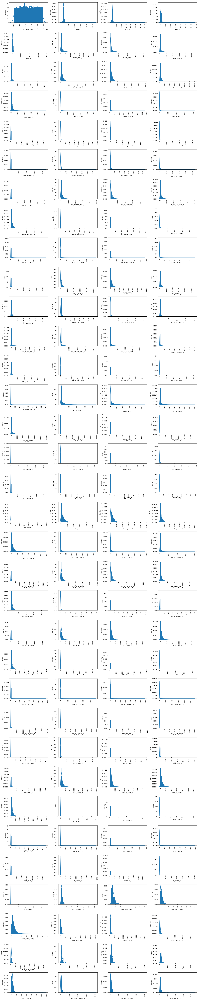

In [198]:
# Checking for distribution using distplot in a 34 by 4 grid
fig, ax = plt.subplots(34, 4, figsize=(20, 100))
for variable, subplot in zip(num_col, ax.flatten()):
    sns.distplot(telecom_data[variable], ax=subplot,kde=True, bins=50, hist_kws={'alpha': 1})
    for label in subplot.get_xticklabels():
        label.set_rotation(90)
plt.tight_layout()
plt.show()

### **Tagging *Churn* (TARGET variable)**

In [199]:
telecom_data['total_og_mou_9']

0           0.00
7           0.00
8         142.18
21       1031.53
23        127.63
          ...   
99981      64.21
99984      14.44
99986    1095.24
99988     182.16
99997       0.00
Name: total_og_mou_9, Length: 30001, dtype: float64

In [200]:
#Calculate total call in mins by adding Incoming and Outgoing calls
telecom_data['total_calls_9'] = telecom_data.total_ic_mou_9 + telecom_data.total_og_mou_9

In [201]:
# Calculate total 2G and 3G consumption of data
telecom_data["total_data_consumptions"] = telecom_data.vol_2g_mb_9 + telecom_data.vol_3g_mb_9

In [202]:
#Tag 1 as churner  where total_calls_9=0 and total_data_consumptions=0
# else 0 as non-churner
telecom_data["churn"]=telecom_data.apply(lambda row:1 if (row.total_calls_9==0 and row.total_data_consumptions==0) else 0,axis=1)


In [203]:
#check the percentages of churn and non churn data
telecom_data["churn"].value_counts(normalize=True)

0    0.918636
1    0.081364
Name: churn, dtype: float64

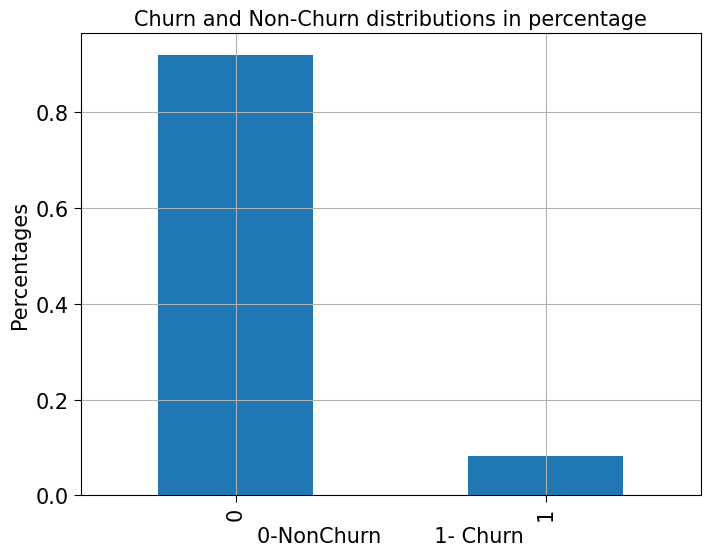

In [204]:
# plot to Check percetanges of churn and non churn data
plt.figure(figsize=(8,6))
telecom_data["churn"].value_counts(normalize=True).plot.bar()
plt.tick_params(size=5,labelsize = 15)
plt.title("Churn and Non-Churn distributions in percentage",fontsize=15)
plt.ylabel("Percentages",fontsize=15)
plt.xlabel("0-NonChurn        1- Churn",fontsize=15)
plt.grid(0.3)
plt.show()

In [205]:
#Drop the derived columns
telecom_data.drop(columns=["total_calls_9","total_data_consumptions"],inplace=True)

### Bi-variate Analysis

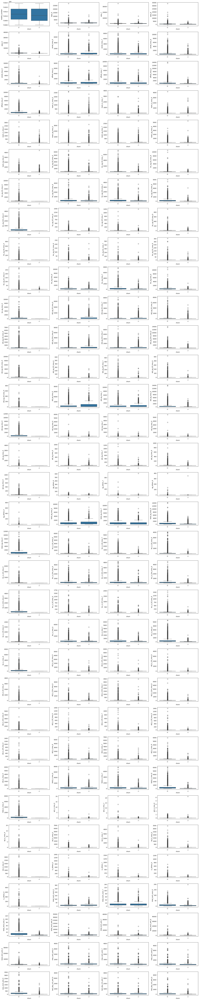

In [206]:
# Bivariate analysis of churn probability with other variables
fig, ax = plt.subplots(34, 4, figsize=(20, 100))
for variable, subplot in zip(num_col, ax.flatten()):
    sns.boxplot(x='churn', y=variable, data=telecom_data, ax=subplot)
    for label in subplot.get_xticklabels():
        label.set_rotation(90)
plt.tight_layout()
plt.show()

### Outliers

In [207]:
# Column list with id and target variable
num_col=telecom_data.select_dtypes(include= np.number).columns.tolist()

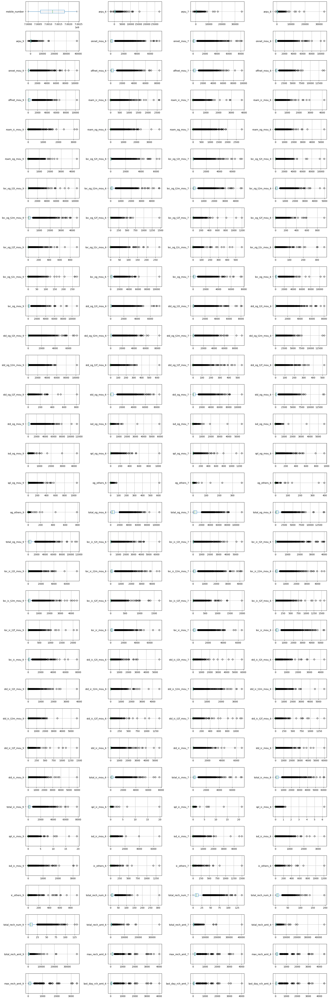

In [208]:
# Checking for outliers using boxplot in a 34 by 4 grid
fig, ax = plt.subplots(34, 4, figsize=(20, 60))
for variable, subplot in zip(num_col, ax.flatten()):
    telecom_data.boxplot(column=variable, ax=subplot, vert=False)
plt.tight_layout()
plt.show()

In [209]:
# Cappign the outliers
for col in num_col:
    perc = telecom_data[col].quantile([0.05,0.95]).values
    telecom_data[col]= np.clip(telecom_data[col],perc[0],perc[1])

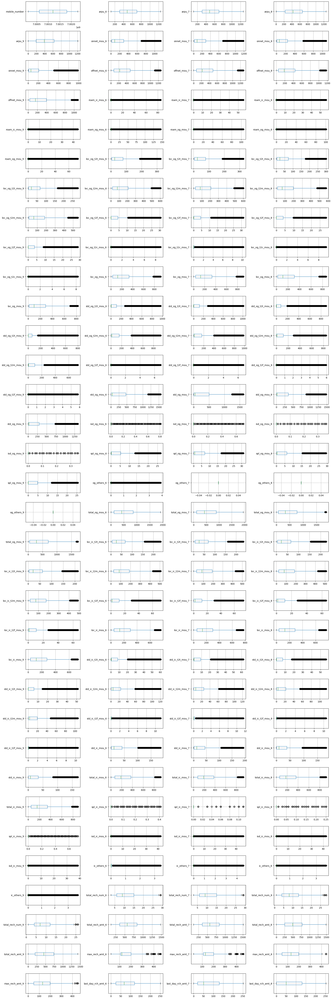

In [210]:
# Checking for outliers using boxplot in a 34 by 4 grid
fig, ax = plt.subplots(34, 4, figsize=(20, 60))
for variable, subplot in zip(num_col, ax.flatten()):
    telecom_data.boxplot(column=variable, ax=subplot, vert=False)
plt.tight_layout()
plt.show()

We observe that after treating our dataset for outliers, only few extreme values remain. We choose to proceed with this dataset as treating them beyond this point will hamper our dataset.

In [211]:
# Observing the correlation among these numerical predictor variables

corr = telecom_data.corr()
corr.loc[:, :] = np.tril(corr, -1)
corr = corr.stack()
high_corr_value = corr[(corr > 0.83) | (corr < -0.85)]
high_corr_value.sort_values(ascending=False)


total_rech_amt_9  arpu_9              0.949112
total_rech_amt_8  arpu_8              0.944244
total_rech_amt_6  arpu_6              0.939252
total_rech_amt_7  arpu_7              0.933112
total_ic_mou_9    loc_ic_mou_9        0.922894
loc_ic_mou_9      loc_ic_t2m_mou_9    0.916703
total_ic_mou_8    loc_ic_mou_8        0.915969
total_ic_mou_6    loc_ic_mou_6        0.915001
loc_ic_mou_8      loc_ic_t2m_mou_8    0.914521
total_ic_mou_7    loc_ic_mou_7        0.910177
loc_og_mou_9      loc_og_t2m_mou_9    0.909053
loc_ic_mou_6      loc_ic_t2m_mou_6    0.904931
loc_og_mou_8      loc_og_t2m_mou_8    0.902802
loc_ic_mou_7      loc_ic_t2m_mou_7    0.902185
loc_og_mou_6      loc_og_t2m_mou_6    0.893869
loc_og_mou_7      loc_og_t2m_mou_7    0.890726
std_ic_mou_9      std_ic_t2m_mou_9    0.884189
std_ic_mou_8      std_ic_t2m_mou_8    0.882541
std_ic_mou_6      std_ic_t2m_mou_6    0.878421
std_ic_mou_7      std_ic_t2m_mou_7    0.873768
std_og_t2t_mou_7  onnet_mou_7         0.872081
roam_og_mou_6

In [212]:
telecom_data.drop(['total_rech_amt_9', 'total_rech_amt_8', 'total_rech_amt_7', 'total_rech_amt_6', 'total_ic_mou_9',
              'loc_ic_mou_9', 'total_ic_mou_8', 'total_ic_mou_6','loc_ic_mou_8','total_ic_mou_7'], axis=1, inplace=True)

### Delete columns belong to the 9th month :Churn Month
- After tagging churners, remove all the attributes corresponding to the churn phase
(all attributes having ‘ _9’, etc. in their names.

- These columns  contain data for users, where these users are already churned.
- Hence those will not contribute anything to churn prediction.

In [219]:
telecom_data.shape

(30001, 126)

In [220]:
# drop all 9th month columns
telecom_data = telecom_data.filter(regex='[^9]$',axis=1)
telecom_data

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,...,sachet_3g_8,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,total_rech_amt_data_6,total_rech_amt_data_7,total_rech_amt_data_8,avg_rech_amt_6_7,churn
0,7000842753,197.385,214.816,213.803,0.00,0.00,0.00,0.21,0.05,0.00,...,0,968,30.40,0.00,101.20,252.0,252.0,252.0,559.0,1
7,7000701601,1069.180,1261.272,1255.019,57.84,54.68,52.29,453.43,567.16,325.91,...,0,802,57.74,19.38,18.74,0.0,0.0,0.0,1185.0,1
8,7001524846,378.721,492.223,137.362,413.69,351.03,35.08,94.66,80.63,136.48,...,0,315,21.03,910.65,122.16,0.0,354.0,207.0,696.0,0
21,7002124215,514.453,597.753,637.760,102.41,132.11,85.14,757.93,896.68,983.39,...,0,720,0.00,0.00,0.00,0.0,0.0,0.0,640.0,0
23,7000887461,112.510,193.897,366.966,48.96,50.66,33.58,85.41,89.36,205.89,...,1,604,40.45,51.86,0.00,0.0,712.0,540.0,583.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99981,7000630859,384.316,255.405,393.474,78.68,29.04,103.24,56.13,28.09,61.44,...,0,473,938.56,619.59,668.05,252.0,252.0,252.0,564.0,0
99984,7000661676,328.594,202.966,118.707,423.99,181.83,5.71,39.51,39.81,18.26,...,0,820,0.00,0.00,0.00,154.0,484.0,585.0,618.5,0
99986,7001729035,644.973,455.228,564.334,806.73,549.36,775.41,784.76,617.13,595.44,...,0,2696,497.45,598.67,604.08,17.0,14.0,25.0,864.0,0
99988,7002111859,312.558,512.932,402.080,199.89,174.46,2.46,175.88,277.01,248.33,...,0,328,104.73,0.00,0.00,0.0,154.0,154.0,544.0,0


In [221]:
telecom_data.shape

(30001, 126)

In [222]:
# check the baisc info of customer
telecom_data.info(verbose=1)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30001 entries, 0 to 99997
Data columns (total 126 columns):
 #    Column                 Dtype  
---   ------                 -----  
 0    mobile_number          int64  
 1    arpu_6                 float64
 2    arpu_7                 float64
 3    arpu_8                 float64
 4    onnet_mou_6            float64
 5    onnet_mou_7            float64
 6    onnet_mou_8            float64
 7    offnet_mou_6           float64
 8    offnet_mou_7           float64
 9    offnet_mou_8           float64
 10   roam_ic_mou_6          float64
 11   roam_ic_mou_7          float64
 12   roam_ic_mou_8          float64
 13   roam_og_mou_6          float64
 14   roam_og_mou_7          float64
 15   roam_og_mou_8          float64
 16   loc_og_t2t_mou_6       float64
 17   loc_og_t2t_mou_7       float64
 18   loc_og_t2t_mou_8       float64
 19   loc_og_t2m_mou_6       float64
 20   loc_og_t2m_mou_7       float64
 21   loc_og_t2m_mou_8       float64
 2

In [223]:
# check the baisc info of customer
telecom_data.info(verbose=1)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30001 entries, 0 to 99997
Data columns (total 126 columns):
 #    Column                 Dtype  
---   ------                 -----  
 0    mobile_number          int64  
 1    arpu_6                 float64
 2    arpu_7                 float64
 3    arpu_8                 float64
 4    onnet_mou_6            float64
 5    onnet_mou_7            float64
 6    onnet_mou_8            float64
 7    offnet_mou_6           float64
 8    offnet_mou_7           float64
 9    offnet_mou_8           float64
 10   roam_ic_mou_6          float64
 11   roam_ic_mou_7          float64
 12   roam_ic_mou_8          float64
 13   roam_og_mou_6          float64
 14   roam_og_mou_7          float64
 15   roam_og_mou_8          float64
 16   loc_og_t2t_mou_6       float64
 17   loc_og_t2t_mou_7       float64
 18   loc_og_t2t_mou_8       float64
 19   loc_og_t2m_mou_6       float64
 20   loc_og_t2m_mou_7       float64
 21   loc_og_t2m_mou_8       float64
 2

In [224]:
telecom_data.head()

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,...,sachet_3g_8,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,total_rech_amt_data_6,total_rech_amt_data_7,total_rech_amt_data_8,avg_rech_amt_6_7,churn
0,7000842753,197.385,214.816,213.803,0.00,0.00,0.00,0.21,0.05,0.00,...,0,968,30.40,0.00,101.20,252.0,252.0,252.0,559.0,1
7,7000701601,1069.180,1261.272,1255.019,57.84,54.68,52.29,453.43,567.16,325.91,...,0,802,57.74,19.38,18.74,0.0,0.0,0.0,1185.0,1
8,7001524846,378.721,492.223,137.362,413.69,351.03,35.08,94.66,80.63,136.48,...,0,315,21.03,910.65,122.16,0.0,354.0,207.0,696.0,0
21,7002124215,514.453,597.753,637.760,102.41,132.11,85.14,757.93,896.68,983.39,...,0,720,0.00,0.00,0.00,0.0,0.0,0.0,640.0,0
23,7000887461,112.510,193.897,366.966,48.96,50.66,33.58,85.41,89.36,205.89,...,1,604,40.45,51.86,0.00,0.0,712.0,540.0,583.0,0


### **Modelling**

In [225]:
# Import library
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import FeatureUnion
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from imblearn.metrics import sensitivity_specificity_support
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.svm import SVC
#check area under the curve
from sklearn.metrics import accuracy_score
# Importing decision tree classifier from sklearn library
from sklearn.tree import DecisionTreeClassifier

In [226]:
# Putting feature variables into X
X = telecom_data.drop(['mobile_number','churn'], axis=1)

In [227]:
# Putting target variable to y
y = telecom_data['churn']

In [228]:
# Splitting data into train and test set 80:20
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, test_size=0.2, random_state=100)

In [229]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((24000, 124), (6001, 124), (24000,), (6001,))

**Dealing with data imbalance**

We are creating synthetic samples by doing upsampling using SMOTE(Synthetic Minority Oversampling Technique).

In [230]:
# Imporing SMOTE
from imblearn.over_sampling import SMOTE

In [231]:
# Instantiate SMOTE
sm = SMOTE(random_state=27)

In [232]:
# Fittign SMOTE to the train set
X_train, y_train = sm.fit_resample(X, y)

In [233]:
X_train.shape, y_train.shape

((55120, 124), (55120,))

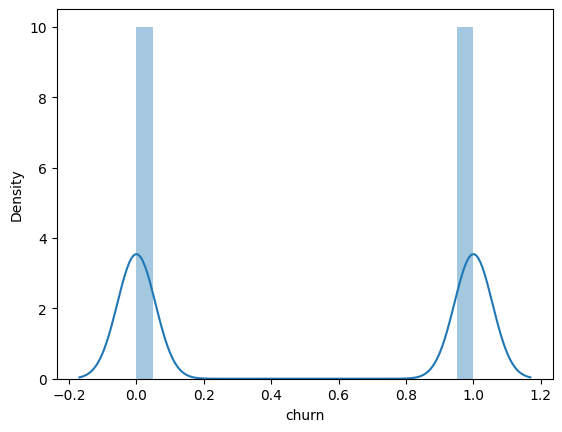

In [234]:
sns.distplot(y_train)
plt.show()

**Feature Scaling**

In [235]:
X_train.select_dtypes(include='object')

""
0
1
2
3
4
...
55115
55116
55117
55118


Hence there is no object type columns

In [236]:
## Scaling the train and test data
cols_scale = X_train.columns.to_list()
scale = StandardScaler()
X_train[cols_scale] = scale.fit_transform(X_train[cols_scale])
X_test[cols_scale] = scale.fit_transform(X_test[cols_scale])
X_train.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,...,sachet_3g_7,sachet_3g_8,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,total_rech_amt_data_6,total_rech_amt_data_7,total_rech_amt_data_8,avg_rech_amt_6_7
0,-1.163413,-0.981469,-0.420007,-0.743065,-0.698004,-0.561453,-0.962504,-0.902532,-0.718071,-0.396478,...,-0.277269,-0.230072,-0.074524,-0.262559,-0.448987,-0.018578,-0.125179,-0.129556,0.092712,-0.748984
1,1.622539,2.406295,2.686263,-0.575759,-0.535013,-0.362232,0.248304,0.647201,0.365973,0.378471,...,-0.277269,-0.230072,-0.271432,-0.136563,-0.370277,-0.376839,-0.582791,-0.545157,-0.425289,0.312470
2,-0.583927,-0.083400,-0.648054,0.453562,0.348350,-0.427801,-0.710174,-0.682333,-0.264111,-0.396478,...,-0.277269,-0.230072,-0.849109,-0.305741,3.249527,0.072487,-0.582791,0.038663,0.000211,-0.516685
3,-0.150175,0.258239,0.844789,-0.446837,-0.304209,-0.237076,1.061795,1.547675,2.552887,-0.396478,...,-0.277269,-0.230072,-0.368700,-0.402658,-0.448987,-0.458259,-0.582791,-0.545157,-0.425289,-0.611640
4,-1.434644,-1.049192,0.036926,-0.601445,-0.546996,-0.433516,-0.734886,-0.658476,-0.033239,-0.396478,...,-0.277269,4.346462,-0.506299,-0.216244,-0.238363,-0.458259,-0.582791,0.629080,0.684713,-0.708290


In [237]:
X_train.value_counts

<bound method DataFrame.value_counts of          arpu_6    arpu_7    arpu_8  onnet_mou_6  onnet_mou_7  onnet_mou_8  \
0     -1.163413 -0.981469 -0.420007    -0.743065    -0.698004    -0.561453   
1      1.622539  2.406295  2.686263    -0.575759    -0.535013    -0.362232   
2     -0.583927 -0.083400 -0.648054     0.453562     0.348350    -0.427801   
3     -0.150175  0.258239  0.844789    -0.446837    -0.304209    -0.237076   
4     -1.434644 -1.049192  0.036926    -0.601445    -0.546996    -0.433516   
...         ...       ...       ...          ...          ...          ...   
55115 -0.056190 -0.230537 -0.320533    -0.588335    -0.425375    -0.273393   
55116  1.056628  0.516837 -1.029357     2.541274     2.836611    -0.557649   
55117 -0.188899 -0.358931 -0.721412     0.492049     0.115820    -0.346227   
55118  0.267266 -0.097652 -1.029357     0.098061    -0.296871    -0.561453   
55119 -1.109602 -1.306964 -0.951561    -0.734211    -0.685534    -0.515331   

       offnet_mou_6  of

### **Model with PCA**

In [238]:
# Instantiate PCA
pca = PCA(random_state=42)

In [239]:
# Fit train set on PCA
pca.fit(X_train)

PCA(random_state=42)

In [240]:
# Principal components
pca.components_

array([[ 1.02430261e-01,  1.46808220e-01,  1.68559861e-01, ...,
        -3.87482370e-02, -2.76524850e-03,  3.11524061e-02],
       [-8.40892241e-02, -7.34993239e-02, -4.14700631e-03, ...,
         1.21733519e-01,  1.13518684e-01,  6.81567798e-02],
       [ 6.65484757e-03,  1.16498849e-01,  1.59064719e-01, ...,
         1.06247031e-01,  1.26133273e-01,  1.28221780e-01],
       ...,
       [-1.16792440e-03,  3.55034488e-03, -4.84027279e-03, ...,
        -2.96648866e-03,  1.74906246e-04,  7.04126410e-04],
       [ 0.00000000e+00, -6.99610538e-17,  2.45960498e-16, ...,
         1.96755992e-17, -1.64395485e-16, -3.82108816e-17],
       [-0.00000000e+00, -2.13326636e-16,  1.21515397e-16, ...,
         9.14957791e-17, -6.38451679e-17,  7.16583289e-17]])

In [241]:
comp = pd.DataFrame(pca.components_, columns=X_train.columns)

In [242]:
comp

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,...,sachet_3g_7,sachet_3g_8,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,total_rech_amt_data_6,total_rech_amt_data_7,total_rech_amt_data_8,avg_rech_amt_6_7
0,0.102430,1.468082e-01,1.685599e-01,5.220354e-02,7.578703e-02,1.053122e-01,9.994371e-02,1.287715e-01,1.598446e-01,1.179146e-02,...,-1.286903e-02,-3.239356e-03,7.958172e-02,3.506961e-02,1.823106e-02,4.780931e-03,-6.201522e-02,-3.874824e-02,-2.765249e-03,3.115241e-02
1,-0.084089,-7.349932e-02,-4.147006e-03,-1.536560e-01,-1.531631e-01,-1.077383e-01,-1.197405e-01,-1.189511e-01,-6.181165e-02,-1.344371e-02,...,5.898884e-02,5.104579e-02,6.342527e-02,1.416203e-01,1.446812e-01,1.375296e-01,1.224474e-01,1.217335e-01,1.135187e-01,6.815678e-02
2,0.006655,1.164988e-01,1.590647e-01,2.221901e-02,7.742478e-02,1.110983e-01,-4.334831e-02,2.912109e-02,8.286398e-02,4.936673e-02,...,4.721857e-02,5.653254e-02,-3.671904e-02,1.506565e-01,1.427577e-01,1.143623e-01,6.606603e-02,1.062470e-01,1.261333e-01,1.282218e-01
3,-0.093686,-7.213984e-03,5.845678e-02,-1.332350e-02,3.769803e-02,8.506371e-02,-4.853298e-02,6.247238e-03,5.871210e-02,-1.298301e-01,...,1.085081e-01,1.136049e-01,-5.773600e-02,1.794162e-02,-1.090236e-03,-2.332853e-02,1.335403e-01,1.852400e-01,1.724667e-01,1.289658e-01
4,-0.076014,-7.182130e-02,-5.417529e-02,-1.396138e-01,-1.461015e-01,-1.241862e-01,1.788159e-03,4.954351e-03,3.351926e-03,5.570360e-02,...,3.790739e-02,3.484406e-02,-5.443473e-03,-6.047577e-02,-6.113298e-02,-5.311680e-02,5.194414e-02,6.307916e-02,3.510718e-02,1.672883e-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119,0.010489,-1.831528e-02,8.621669e-03,-1.899570e-01,3.037518e-01,-1.296016e-01,-5.314916e-02,3.674717e-02,4.885243e-02,6.090563e-03,...,6.819570e-04,-3.455718e-04,-3.194008e-04,1.057179e-04,8.546391e-04,-3.990051e-04,-9.202128e-04,2.423553e-03,-9.704502e-04,-1.318271e-04
120,0.000549,4.604976e-03,-6.481940e-03,-4.556802e-02,-1.086854e-01,1.618959e-01,-1.140356e-01,-2.319540e-02,1.195368e-01,2.908532e-03,...,-5.788826e-04,2.273407e-04,-4.598519e-05,1.089022e-03,-2.924860e-04,-5.321767e-04,2.492984e-03,2.470600e-03,1.886089e-03,-3.792804e-03
121,-0.001168,3.550345e-03,-4.840273e-03,5.633088e-02,-1.648684e-01,8.134831e-02,5.570779e-02,-1.505026e-01,8.772780e-02,-1.852325e-03,...,3.343547e-04,3.089157e-04,3.755602e-04,1.999002e-04,-8.916708e-04,1.235504e-04,4.211760e-04,-2.966489e-03,1.749062e-04,7.041264e-04
122,0.000000,-6.996105e-17,2.459605e-16,-7.249121e-17,-1.558119e-16,-9.055548e-17,2.188211e-16,-2.306269e-16,3.996558e-16,1.469189e-16,...,3.772009e-17,6.751369e-17,-1.138739e-16,1.187230e-16,-7.024465e-17,-2.852360e-17,-1.829804e-16,1.967560e-17,-1.643955e-16,-3.821088e-17


In [243]:
# Cumuliative varinace of the PCs
variance_cumu = np.cumsum(pca.explained_variance_ratio_)
print(variance_cumu)

[0.13330575 0.24389883 0.30351972 0.35382534 0.39370942 0.42746121
 0.45993431 0.48885239 0.51402959 0.53541641 0.55642559 0.57548441
 0.59217884 0.60845019 0.62345217 0.63747688 0.65092153 0.6642955
 0.67680112 0.68827153 0.6983429  0.70820356 0.71770929 0.7269316
 0.73592124 0.74426631 0.75226465 0.76018071 0.76790101 0.77531804
 0.78259801 0.78967173 0.79645998 0.80319947 0.80982299 0.81608609
 0.822256   0.82824174 0.83402368 0.8396892  0.84520732 0.85048644
 0.85567664 0.86080349 0.86579565 0.8705527  0.87524219 0.87983734
 0.88423105 0.88856356 0.8928754  0.89704311 0.90107573 0.90501919
 0.90885412 0.91259465 0.91612919 0.91964166 0.92305038 0.92632419
 0.92946391 0.9325602  0.93555674 0.93835971 0.9410406  0.94360051
 0.94607922 0.94848323 0.95081861 0.95311565 0.9553363  0.95746568
 0.95956091 0.96164039 0.96367381 0.96565223 0.96751336 0.96936297
 0.97111773 0.97284094 0.97450376 0.97609089 0.9776258  0.97911111
 0.98054199 0.98189967 0.98311706 0.98427154 0.98533833 0.986376

Text(0, 0.5, 'Cumulative Variance')

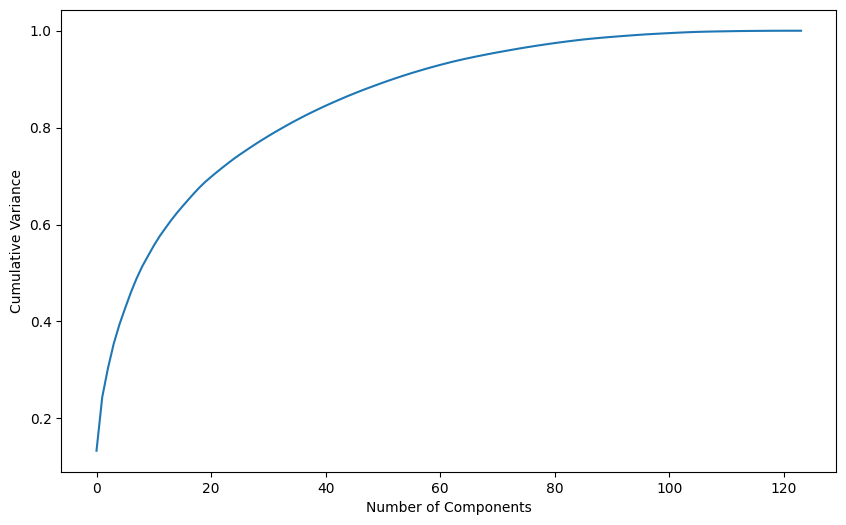

In [244]:
# Plotting scree plot
fig = plt.figure(figsize = (10,6))
plt.plot(variance_cumu)
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Variance')

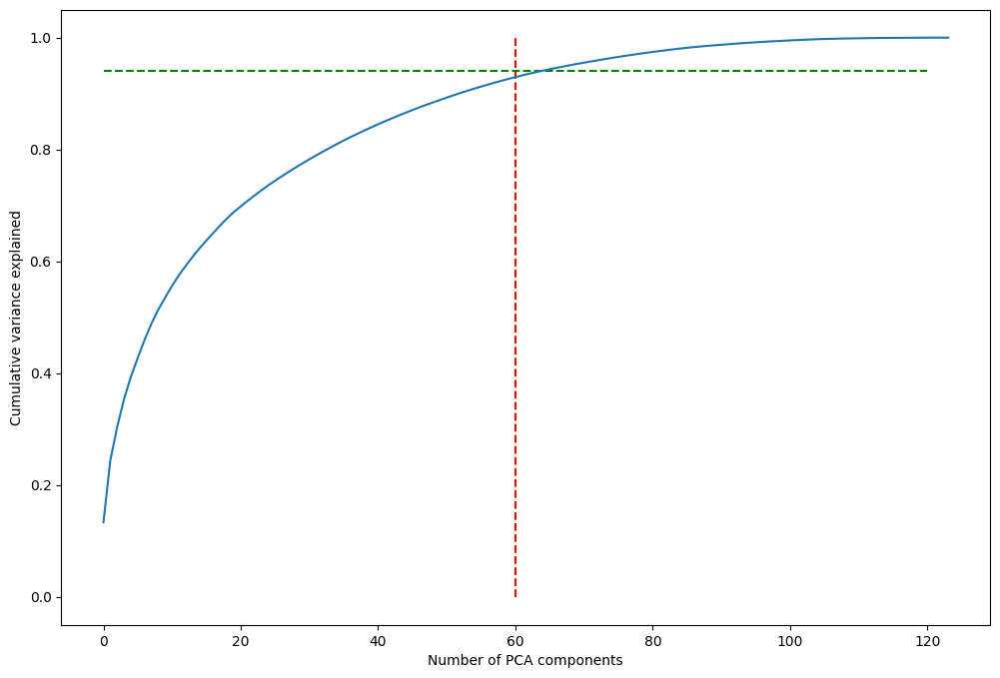

In [245]:
fig = plt.figure(figsize=[12,8])
plt.vlines(x=60, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=.94, xmax=120, xmin=0, colors="g", linestyles="--")
plt.plot(variance_cumu)
plt.xlabel('Number of PCA components')
plt.ylabel("Cumulative variance explained")
plt.show()

Looks like 60 components are enough to describe 94% of the variance in the dataset. We'll choose 60 components for our modeling

In [246]:
# Importing incremental PCA
from sklearn.decomposition import IncrementalPCA

In [247]:
# Instantiate PCA with 40 components
pca_final = IncrementalPCA(n_components=60)

In [248]:
# Fit and transform the X_train
X_train_pca = pca_final.fit_transform(X_train)

In [249]:
print("Size of earlier dataset was :",X_train.shape)
print("Size of dataset after PCA is:", X_train_pca.shape)

Size of earlier dataset was : (55120, 124)
Size of dataset after PCA is: (55120, 60)


Applying transformation on the test set
We are only doing Transform in the test set not the Fit-Transform. Because the Fitting is already done on the train set. So, we just have to do the transformation with the already fitted data on the train set.

In [250]:
#creating correlation matrix for the given data
corrmat = np.corrcoef(X_train_pca.transpose())

#Make a diagonal matrix with diagonal entry of Matrix corrmat
p = np.diagflat(corrmat.diagonal())

# subtract diagonal entries making all diagonals 0
corrmat_diag_zero = corrmat - p
print("max positive corr:",round(corrmat_diag_zero.max(),3), ", min negative corr: ", round(corrmat_diag_zero.min(),3))

max positive corr: 0.005 , min negative corr:  -0.008


We can see from the above calculations that the correlation among the attributes is almost 0, we can proceed with these principal components.

In [251]:
X_test_pca = pca_final.transform(X_test)
X_test_pca.shape


(6001, 60)

### **Logistic regression with PCA**

In [81]:
X_train_pca.shape, y_train.shape

((55120, 60), (55120,))

In [82]:
from sklearn.model_selection import KFold

# Creating KFold object with 5 splits
folds = KFold(n_splits=5, shuffle=True, random_state=4)

# Specify params
params = {"C": [0.01, 0.1, 1, 10, 100, 1000]}

# Specifing score as recall as we are more focused on acheiving the higher sensitivity than the accuracy
model_cv = GridSearchCV(estimator = LogisticRegression(),
                        param_grid = params,
                        scoring= 'recall',
                        cv = folds,
                        verbose = 1,
                        return_train_score=True)

# Fit the model
model_cv.fit(X_train_pca, y_train)

Fitting 5 folds for each of 6 candidates, totalling 30 fits


GridSearchCV(cv=KFold(n_splits=5, random_state=4, shuffle=True),
             estimator=LogisticRegression(),
             param_grid={'C': [0.01, 0.1, 1, 10, 100, 1000]},
             return_train_score=True, scoring='recall', verbose=1)

In [83]:
# Best score with best C
best_score = model_cv.best_score_
best_C = model_cv.best_params_['C']

print(" The highest test sensitivity is {0} at C = {1}".format(best_score, best_C))

 The highest test sensitivity is 0.9958998495055473 at C = 0.1


In [84]:
# Instantiate the model with best C
logistic_pca = LogisticRegression(C=best_C)

In [85]:
# Fit the model on the train set
log_pca_model = logistic_pca.fit(X_train_pca, y_train)

In [86]:
# Predictions on the train set
y_train_pred_log = log_pca_model.predict(X_train_pca)

In [87]:
# Confusion matrix
confusion = confusion_matrix(y_train, y_train_pred_log)
print(confusion)

[[26769   791]
 [  105 27455]]


In [88]:
#checking sesitivity
print("sensitivity \t", (confusion[1,1]/(confusion[1,0]+confusion[1,1])).round(2))
#checking  specificity
print("specificity \t", (confusion[0,0]/(confusion[0,0]+confusion[0,1])).round(2))
print("accuracy_score \t",round(accuracy_score(y_train,y_train_pred_log),2))

sensitivity 	 1.0
specificity 	 0.97
accuracy_score 	 0.98


**Prediction on the test set**

In [89]:
# Prediction on the test set
y_test_pred_log = log_pca_model.predict(X_test_pca)
# Confusion matrix
con1 = confusion_matrix(y_test, y_test_pred_log)
print(con1)

[[4524  952]
 [   0  525]]


In [90]:
# Accuracy
print("Accuracy:",accuracy_score(y_test, y_test_pred_log))
#checking sesitivity
print("sensitivity \t", (con1[1,1]/(con1[1,0]+con1[1,1])).round(2))
#checking  specificity
print("specificity \t", (con1[0,0]/(con1[0,0]+con1[0,1])).round(2))

Accuracy: 0.8413597733711048
sensitivity 	 1.0
specificity 	 0.83


#### Regularisation

In [91]:

from sklearn.linear_model import Lasso, Ridge
# list of alphas to tune - if value too high it will lead to underfitting, if it is too low,
# it will not handle the overfitting
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1,
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

ridge = Ridge()

# cross validation
folds = 5
model_cv = GridSearchCV(estimator = ridge,
                        param_grid = params,
                        scoring= 'neg_mean_absolute_error',
                        cv = folds,
                        return_train_score=True,
                        verbose = 1)
model_cv.fit(X_train_pca, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [92]:
# Printing the best hyperparameter alpha
print(model_cv.best_params_)

{'alpha': 0.0001}


In [93]:
#Fitting Ridge model for alpha = 0.0001 and printing coefficients which have been penalised
alpha = 0.0001
ridge = Ridge(alpha=alpha)

ridge.fit(X_train_pca, y_train)
print(ridge.coef_)

[-6.33921970e-02  2.41441265e-02  5.45778366e-02 -4.84121131e-02
 -6.10045115e-03  5.24622847e-02 -8.08218646e-03  1.66468234e-02
  1.97947728e-02 -7.19712936e-03  1.12147826e-02 -4.68016859e-02
 -8.53285761e-04 -2.21642030e-02  3.01522871e-02  1.03015646e-02
 -4.27850937e-03  6.37803241e-03 -3.93771461e-03  1.58234176e-02
 -8.46797276e-03 -5.09587248e-03  1.81696774e-02  7.18266533e-03
 -2.13550905e-02 -6.85004818e-03 -5.49481373e-03 -1.55285634e-03
 -7.40833560e-03 -8.75398142e-05  1.77792485e-03 -5.40591579e-03
  2.60941154e-02  2.07779222e-02  6.40896583e-03 -5.06493375e-03
  3.90576532e-03 -7.64724693e-03 -3.61764133e-03 -3.06290967e-03
 -1.88609166e-02 -2.08866224e-02 -3.70920996e-03  1.25837202e-02
 -4.40687479e-03  1.88785131e-02 -8.00691862e-03  1.07124349e-03
 -4.55699317e-03  4.79705459e-03  8.64497259e-03  3.00924739e-02
  7.78156456e-03 -9.70780082e-03  1.24376039e-02  8.20060282e-03
 -1.19244721e-02  2.42930229e-04 -9.69828782e-04 -7.40765571e-03]


In [94]:
X_pred_train_reg = ridge.predict(X_train_pca)
X_pred_test_reg = ridge.predict(X_test_pca)

### Decision tree with PCA

In [107]:
# Importing required packages for visualization
from IPython.display import Image
from six import StringIO
from sklearn.tree import export_graphviz
import pydotplus, graphviz

In [109]:
dt = DecisionTreeClassifier(max_depth=3)
dt.fit(X_train_pca, y_train)

DecisionTreeClassifier(max_depth=3)

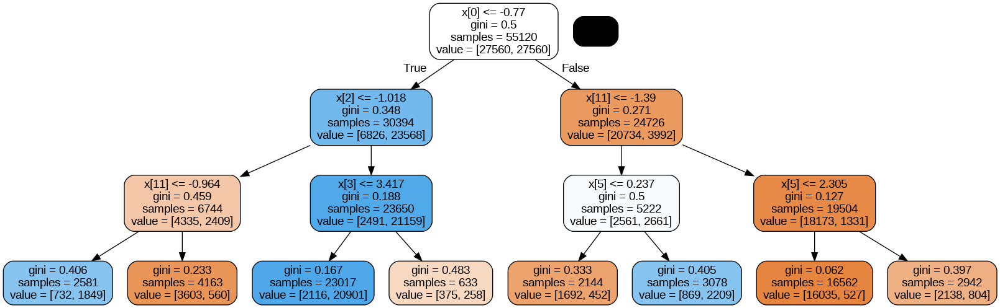

In [110]:
# plotting tree with max_depth=3
dot_data = StringIO()

export_graphviz(dt, out_file=dot_data, filled=True, rounded=True
                )

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

In [111]:
y_train_pred = dt.predict(X_train_pca)
y_test_pred = dt.predict(X_test_pca)

In [112]:
print(accuracy_score(y_train, y_train_pred))
confusion_matrix(y_train, y_train_pred)

0.8853773584905661


array([[23843,  3717],
       [ 2601, 24959]])

In [113]:
print(accuracy_score(y_test, y_test_pred))
confusion_matrix(y_test, y_test_pred)

0.7368771871354775


array([[3921, 1555],
       [  24,  501]])

In [104]:
# Model with optimal hyperparameters
dt_pca_model = DecisionTreeClassifier(criterion = "gini",
                                  random_state = 100,
                                  max_depth=15,
                                  min_samples_leaf=70,
                                  min_samples_split=50)

dt_pca_model.fit(X_train_pca, y_train)

DecisionTreeClassifier(max_depth=15, min_samples_leaf=70, min_samples_split=50,
                       random_state=100)

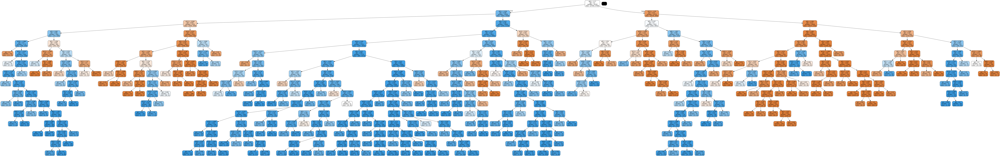

In [114]:
# plotting tree with max_depth=10
dot_data = StringIO()

export_graphviz(dt_pca_model, out_file=dot_data, filled=True, rounded=True
                )

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Prediction on the train set

In [115]:
# Predictions on the train set
X_train_pred_tree = dt_pca_model.predict(X_train_pca)
# Confusion matrix
confusion = confusion_matrix(y_train, X_train_pred_tree)
print(confusion)

TP = confusion[1,1] # true positive
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives
# Accuracy
print("Accuracy:-",accuracy_score(y_train, X_train_pred_tree))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

[[25742  1818]
 [ 1372 26188]]
Accuracy:- 0.9421262699564587
Sensitivity:- 0.9502177068214804
Specificity:- 0.9340348330914369


Prediction on the test set

In [116]:
# Prediction on the test set
X_test_pred_tree = dt_pca_model.predict(X_test_pca)
# Confusion matrix
confusion = confusion_matrix(y_test, X_test_pred_tree)
print(confusion)

TP = confusion[1,1] # true positive
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives
# Accuracy
print("Accuracy:-",accuracy_score(y_test, X_test_pred_tree))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

[[4435 1041]
 [  29  496]]
Accuracy:- 0.8216963839360106
Sensitivity:- 0.9447619047619048
Specificity:- 0.8098977355734113


### Random forest with PCA

#### Grid search for hyper-parameter without tuning

In [118]:
from sklearn.ensemble import RandomForestClassifier
# Importing required packages for visualization
from IPython.display import Image
from six import StringIO
from sklearn.tree import export_graphviz
import pydotplus, graphviz

In [119]:
def get_dt_graph(dt_classifier):
    dot_data = StringIO()
    export_graphviz(dt_classifier, out_file=dot_data, filled=True,rounded=True)
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
    return graph

In [120]:
rf = RandomForestClassifier(random_state=42, n_estimators=10, max_depth=3)

In [146]:
print(X_train_pca.shape)
print(y_train.shape)

(55120, 164)
(55120,)


In [147]:
rf.fit(X_train_pca, y_train)

RandomForestClassifier(max_depth=3, n_estimators=10, random_state=42)

In [148]:
rf.estimators_[0]

DecisionTreeClassifier(max_depth=3, max_features='sqrt',
                       random_state=1608637542)

In [149]:
sample_tree = rf.estimators_[4]

In [150]:
sample_tree.feature_importances_


array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.91973862, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.0129729 , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.     

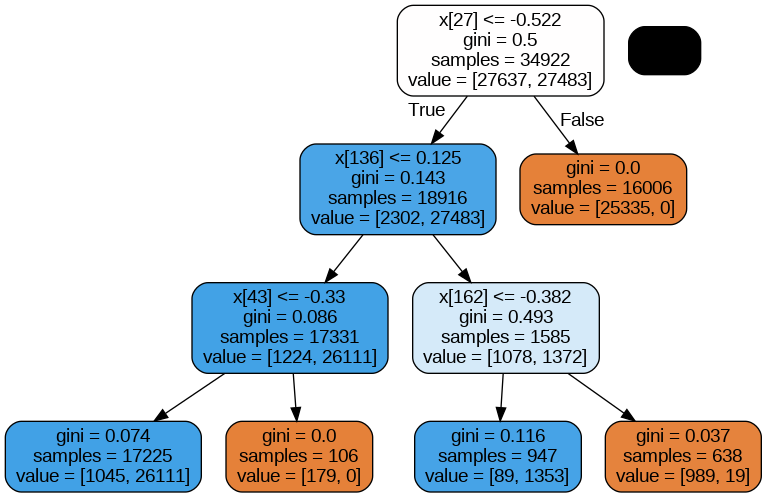

In [151]:
gph = get_dt_graph(sample_tree)
Image(gph.create_png(), width=700, height=700)

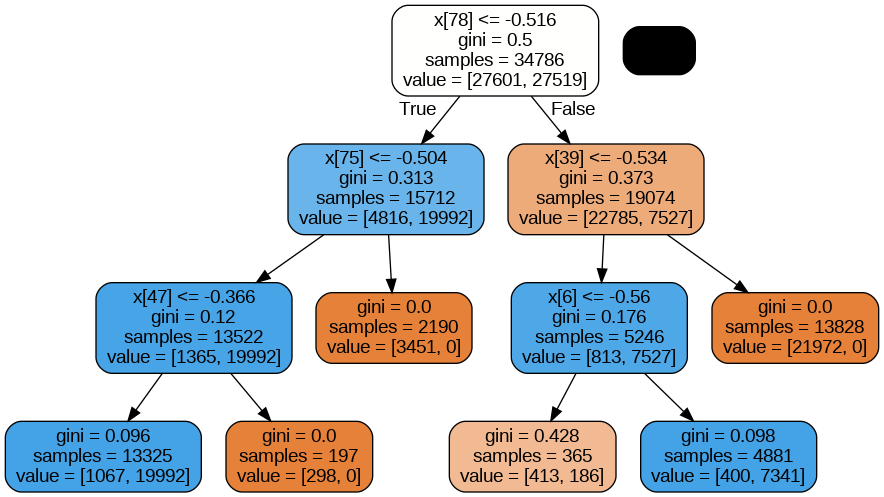

In [152]:
gph = get_dt_graph(rf.estimators_[2])
Image(gph.create_png(), width=700, height=700)

In [155]:
def evaluate_model(dt_classifier):
    print("Train Confusion Matrix:")
    print(confusion_matrix(y_train, dt_classifier.predict(X_train_pca)))
    print("Train Accuracy :", accuracy_score(y_train, dt_classifier.predict(X_train_pca)))

    print("-"*50)

    print("Test Confusion Matrix:")
    print(confusion_matrix(y_test, dt_classifier.predict(X_test_pca)))
    print("Test Accuracy :", accuracy_score(y_test, dt_classifier.predict(X_test_pca)))

In [156]:
evaluate_model(rf)

Train Confusion Matrix:
[[26578   982]
 [    0 27560]]
Train Accuracy : 0.9821843251088535
--------------------------------------------------
Test Confusion Matrix:
[[4417 1059]
 [   0  525]]
Test Accuracy : 0.8235294117647058


#### **Grid search for hyper-parameter tuning**

In [131]:
classifier_rf = RandomForestClassifier(random_state=42, n_jobs=-1)
# Create the parameter grid based on the results of random search
params = {
    'max_depth': [1, 2, 5, 10, 15],
    'min_samples_leaf': [5, 10, 20,30],
    'max_features': [2,3,4],
    'n_estimators': [10, 30, 50]
}

# Instantiate the grid search model
grid_search = GridSearchCV(estimator=classifier_rf, param_grid=params,
                          cv=4, n_jobs=-1, verbose=1, scoring = "accuracy")

grid_search.fit(X_train_pca,y_train)

Fitting 4 folds for each of 180 candidates, totalling 720 fits


GridSearchCV(cv=4, estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [1, 2, 5, 10, 15],
                         'max_features': [2, 3, 4],
                         'min_samples_leaf': [5, 10, 20, 30],
                         'n_estimators': [10, 30, 50]},
             scoring='accuracy', verbose=1)

In [132]:
rf_best = grid_search.best_estimator_

In [133]:
rf_best

RandomForestClassifier(max_depth=15, max_features=4, min_samples_leaf=5,
                       n_estimators=50, n_jobs=-1, random_state=42)

In [134]:
grid_search.best_estimator_.max_features

4

In [135]:
grid_search.best_estimator_.feature_importances_

array([0.19851115, 0.05745371, 0.0810116 , 0.06820755, 0.01410468,
       0.03642069, 0.00741661, 0.01220504, 0.03724813, 0.01447974,
       0.02463732, 0.03142513, 0.00756618, 0.01575427, 0.02870528,
       0.01580287, 0.01788113, 0.01948501, 0.02592076, 0.01102239,
       0.00868612, 0.00723843, 0.00530114, 0.01348644, 0.00925272,
       0.00647935, 0.00532309, 0.0087059 , 0.00977   , 0.00564518,
       0.00772853, 0.00469723, 0.00586413, 0.00729182, 0.002956  ,
       0.00445283, 0.00697392, 0.00274573, 0.01786944, 0.00249606,
       0.0034026 , 0.00598743, 0.00298277, 0.00363384, 0.00341148,
       0.00868796, 0.00295769, 0.00450244, 0.00317923, 0.00435212,
       0.0045408 , 0.01505161, 0.00859422, 0.00728579, 0.00880231,
       0.00579136, 0.0127692 , 0.01363262, 0.00276921, 0.00944199])

In [136]:
importances = grid_search.best_estimator_.feature_importances_
# Use loadings to associate important features with original feature names
important_feature_names = []
for importance, loading in zip(importances, pca.components_):
  # Find the original feature names that contributed the most to this principal component
  top_original_features = X_train.columns[np.abs(loading).argsort()[-1]]
  important_feature_names.append(top_original_features)

df = pd.DataFrame({'Variable': important_feature_names,'Importance':importances})

In [137]:
df.sort_values(by="Importance", ascending=False)

,Variable,Importance
0,loc_og_mou_8,0.198511
2,loc_og_mou_6,0.081012
3,sachet_2g_7,0.068208
1,std_og_mou_7,0.057454
8,isd_ic_mou_7,0.037248
5,avg_rech_amt_6_7,0.036421
11,arpu_6,0.031425
14,total_rech_amt_data_6,0.028705
18,sachet_3g_8,0.025921
10,loc_og_t2f_mou_7,0.024637


In [138]:
evaluate_model(rf_best)

Train Confusion Matrix:
[[26320  1240]
 [   32 27528]]
Train Accuracy : 0.9769230769230769
--------------------------------------------------
Test Confusion Matrix:
[[4790  686]
 [   3  522]]
Test Accuracy : 0.8851858023662723


In [139]:
sample_tree = rf_best.estimators_[0]

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.536258 to fit



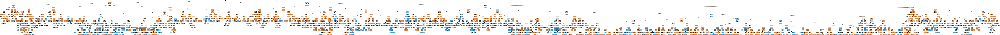

In [140]:
gph = get_dt_graph(sample_tree)
Image(gph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.536258 to fit



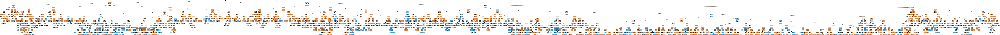

In [141]:
gph = get_dt_graph(rf_best.estimators_[0])
Image(gph.create_png(), height=600, width=600)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.687328 to fit



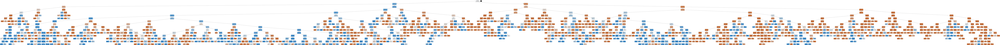

In [142]:
gph = get_dt_graph(rf_best.estimators_[10])
Image(gph.create_png(), height=600, width=600)

In [143]:
# printing the optimal accuracy score and hyperparameters
print('We can get accuracy of',grid_search.best_score_,'using',grid_search.best_params_)

We can get accuracy of 0.9656386066763426 using {'max_depth': 15, 'max_features': 4, 'min_samples_leaf': 5, 'n_estimators': 50}


Prediction on the train set

In [144]:
# Predictions on the train set
y_train_pred = grid_search.predict(X_train_pca)
# Confusion matrix
confusion = confusion_matrix(y_train, y_train_pred)

TP = confusion[1,1] # true positive
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives
# Accuracy
print("Accuracy:-",accuracy_score(y_train, y_train_pred))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

Accuracy:- 0.9769230769230769
Sensitivity:- 0.9988388969521045
Specificity:- 0.9550072568940493


Prediction on the test set

In [145]:
# Prediction on the test set
y_test_pred = grid_search.predict(X_test_pca)
# Confusion matrix
confusion = confusion_matrix(y_test, y_test_pred)
print(confusion)

TP = confusion[1,1] # true positive
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives
# Accuracy
print("Accuracy:-",accuracy_score(y_test, y_test_pred))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

[[4790  686]
 [   3  522]]
Accuracy:- 0.8851858023662723
Sensitivity:- 0.9942857142857143
Specificity:- 0.8747260774287802


## Conclusion:
 In addressing the telecom churn problem, the company prioritizes recall as the key metric, aiming to identify customers at risk of churning, even at the expense of some false positives. The Logistic Regression model, with a probability cut-off of 0.45, proves most effective, achieving an impressive 84.4% recall accuracy on test data. Despite compromised precision, the model ensures consistent overall accuracy and specificity, mitigating overfitting concerns.

The Linear SVM follows with a 78.40% recall rate and slightly improved precision at 35.14%. Among the tree family, the Decision Tree slightly overfits, obtaining a 78.13% recall accuracy, while the Random Forest avoids overfitting but achieves a slightly lower recall rate of 77.57%. Boosting methods exhibit varying results, with the Gradient Boosting Classifier leading at 81.81% recall, albeit with tendencies to overfit.

Strategies for managing churn involve targeting specific customer behaviors, such as lower roaming calls, decreased usage in certain call types, and changes in value-based costs. Additionally, identifying customers with less than four years of tenure, monitoring average revenue per user, and focusing on strong churn indicators like roaming calls and local outgoing calls to specific numbers are crucial. In conclusion, the company should concentrate on retaining high-profit customers, leveraging insights from key indicators to implement targeted retention strategies.